## **[Real-Time Time Series Anomaly Detection](https://towardsdatascience.com/real-time-time-series-anomaly-detection-981cf1e1ca13)**
#### **Develop a Monitoring System on Multiple Time Series Sensors**

As much as it has become easier over the years to collect vast amounts of data across different sources, companies need to ensure that the data they’re gathering can bring value. To aid insight collection from the data, machine learning and analytics have become trending tools. Since these domains require real-time insights, an abundance of unwelcome data can create real issues.

Before decisions are made, and critically, before actions are taken, we must ask: are there anomalies in our data that could skew the results of the algorithmic analysis? If anomalies do exist, it is critical that we automatically detect and mitigate their influence. This ensures that we get the most accurate results possible before taking action.

In this post, we explore different anomaly detection approaches that can scale on a big data source in real-time. The [tsmoothie](https://github.com/cerlymarco/tsmoothie) package can help us to carry out this task. [Tsmoothie](https://github.com/cerlymarco/tsmoothie) is a python library for time series smoothing and outlier detection that can handle multiple series in a vectorized way. It’s useful because it can provide the techniques we needed to monitor sensors over time.

#### **TYPES OF ANOMALIES**

First, let’s define anomalies. They can be anything that is different or abnormal and deviates substantially from other data in the sample or historical data.

Anomalies are often divided into **point and pattern anomalies**. **Point anomalies** are single instances of something abnormal, while **pattern anomalies** represent clusters of data that are abnormal.

In most of the case, some point anomalies may seem like a case of bad luck. With a pattern anomaly instead, the data creates a pattern that looks very different from normal. Pattern anomalies are more difficult to detect because we must first be able to define a normal pattern, and then we could need more data to be able to classify that this pattern is anomalous compared to historical activity.

Below we present different simulated scenarios, where we apply different techniques suitable for anomaly detection. Their adoption is domain-related and they are all based on simple assumptions. This simplicity is fundamental in all the tasks where we have a lack of information or in the presence of a little amount of data.

#### **POINT ANOMALIES**

Our aim here is to detect data points that deviate so much from others. This arouses suspicions that the points were generated by a different mechanism.

Two different algorithms are used: a convolutional smoother and an exponential smoother. Both smooth the received signals using a sliding window approach. The convolution approach uses a discrete linear convolution while the exponential one uses an exponentially weighted convolution. Convolution is a mathematical operation that could be described as the integral of the product of two sequences: the raw signal and the weights. The convolutional smoother uses weights generated using predefined windows function (linear, hanning, hamming, bartlett, blackman). In the case of linear type, the weights are all the same and equal to one. This makes the operation equal to a moving average. The exponential smoother uses weights generated with an exponential function. As result, the most recent observations weight the most when computing the smoothing.

Respectively, two different data structures are taken into account: random walks series and seasonal series with no trend.

<center> <p>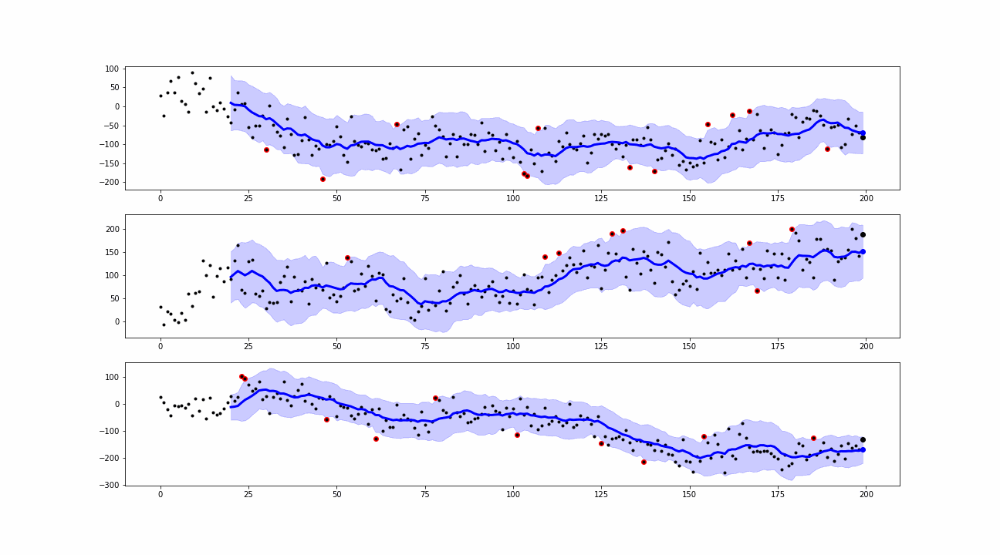</p> </center><font size = "3"><center> Point Anomalies with Convolutional Smoother in Random Walks </center></font>

<center> <p>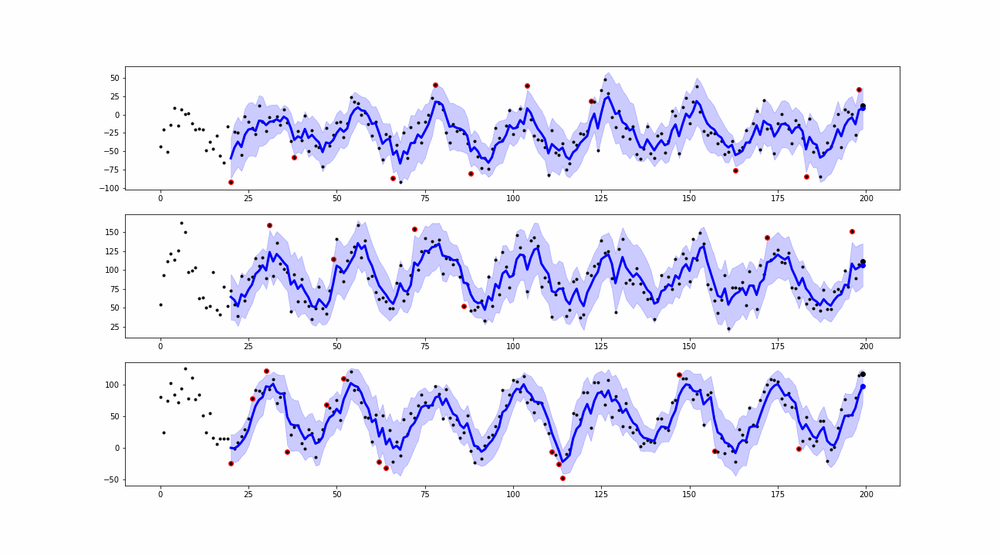</p> </center><font size = "3"><center> Point Anomalies with Exponential Smoother in Seasonal Data without Trend </center></font>

When a new value is collected, the smoothing is computed. The differences between the real observations and the corresponding smoothed values are known as residuals. We use them to define the outliers or anomalies as the points where the real observations exceed the residuals’ confidence bands.

From the simulations, we can see that our approaches are able to detect peaks and insane values which can be classified as point anomalies.

#### **PATTERN ANOMALIES**

Our aim here is to detect a continuous set of data points that are collectively anomalous even though the individual points may or may not be point anomalies. When we are looking for pattern anomalies the underlying assumption is that the raw data must show a pattern. This is the case, for example, of seasonal time series.

**Seasonality in time series is commonly observed in a lot of data. Studying the seasonal component is critical for effective anomaly detection.** In this regard, **a key challenge is how to determine the seasonal period and separate it from trends.** Seasonal-Trend-Decomposition is one of the commonly used approaches for detecting seasonal and trend components. 
- Convolution filtering, LOWESS, or natural-cubic-spline are the techniques used by tsmoothie to detect a trend component.
- While seasonal patterns are detected using a mean aggregation in the periods. 

From the union of the extracted trend and the observed seasonalities, we can build an hypothetical time series of smoothed values.

Seasonal series with trends are taken into account to detect pattern anomalies using a decomposition smoother. In the first case, our aim is to detect observations that don’t respect the studied pattern present so far in the data. For the majority, this is the case of observations that break the seasonality pattern. In the second case, we introduce a shift in some intervals. We want to see if this is detected as a drastic change that can alter the trend and so be pointed out as anomalous.

<center> <p>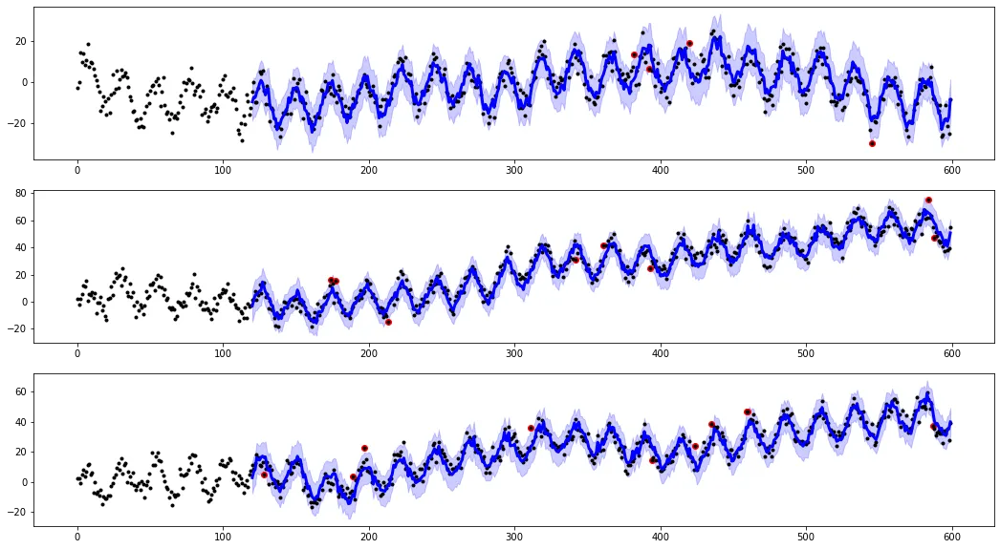</p> </center><font size = "3"><center> Pattern Anomalies with Decomposition Smoother in Seasonal Data with Trend </center></font>

<center> <p>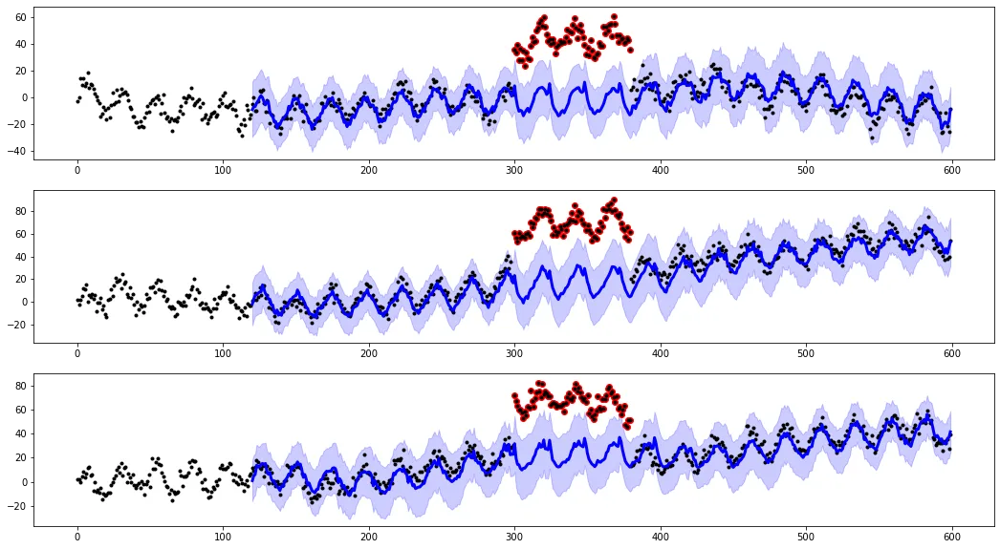</p> </center><font size = "3"><center> Pattern Anomalies with Decomposition Smoother in Seasonal Data with Trend and Shift </center></font>

The smoothing mechanism and the computation of the residuals’ confidence bands work as before.

From the simulations, we can see that our approaches are able to detect peaks that don’t respect the seasonal patterns. We can also point out the pieces where our sensors deviate from the hypothetical pattern present in the past observations. In this last case, we also try to provide a reconstruction of the theoretical signal.

#### **SUMMARY**

In this post, we introduced some standard techniques to develop a monitoring tool for time series data. Our approaches appear to be very useful when we want to detect anomalies but we don’t dispose of much information about the underlying system. The proposed methods are also good to deal with multiple time series at the same time. We have to take care to choose the correct one and make some parameter tuning.

**[Jupyternotebook](./Example_Code/Anomaly_Detection_RealTime/Anomaly_Detection_RealTime.ipynb)**